In [1]:
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline

import re
import os
import os.path
import glob
from PIL import Image
from skimage import io

from sklearn.preprocessing import LabelEncoder
from keras.utils import np_utils

from keras.models import Sequential,Model
from keras.layers import Input,Flatten,Dense,Dropout,GlobalAveragePooling2D,Conv2D,MaxPooling2D
from keras.preprocessing.image import img_to_array
from keras.preprocessing import image
from vis.utils import utils
from keras.applications import VGG16
from vis.visualization import visualize_cam,visualize_saliency, overlay
from keras import activations

# Disable GPU
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

Using TensorFlow backend.


In [2]:
imagedir = "Datasets/malimg_paper_dataset_imgs"

In [3]:
cur_dir = os.getcwd()
os.chdir(imagedir)  # the parent folder with sub-folders

# Get number of samples per family
list_fams = sorted(os.listdir(os.getcwd()), key=str.lower)  # vector of strings with family names
no_imgs = []  # No. of samples per family
for i in range(len(list_fams)):
    os.chdir(list_fams[i])
    len1 = len(glob.glob('*.png'))  # assuming the images are stored as 'png'
    no_imgs.append(len1)
    os.chdir('..')
num_samples = np.sum(no_imgs)  # total number of all samples

# Compute the labels
y = np.zeros(num_samples)
pos = 0
label = 0
for i in no_imgs:
    print ("Label:%2d\tFamily: %15s\tNumber of images: %d" % (label, list_fams[label], i))
    for j in range(i):
        y[pos] = label
        pos += 1
    label += 1
num_classes = label

# Compute the features
width, height,channels = (224,224,3)
X = np.zeros((num_samples, width, height, channels))
cnt = 0
list_paths = [] # List of image paths
print("Processing images ...")
for i in range(len(list_fams)):
    for img_file in image.list_pictures(list_fams[i], ext='jpg|jpeg|bmp|png'):
        #print("[%d] Processing image: %s" % (cnt, img_file))
        list_paths.append(os.path.join(os.getcwd(),img_file))
        img = image.load_img(img_file, target_size=(224, 224))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        X[cnt] = x
        #x /= 255
        #x = preprocess_input(x)
        #X[cnt] = np.array(x).reshape(width*height*channels)
        cnt += 1
print("Images processed: %d" %(cnt))

os.chdir(cur_dir)

Label: 0	Family:       Adialer.C	Number of images: 122
Label: 1	Family:       Agent.FYI	Number of images: 116
Label: 2	Family:       Allaple.A	Number of images: 2949
Label: 3	Family:       Allaple.L	Number of images: 1591
Label: 4	Family:   Alueron.gen!J	Number of images: 198
Label: 5	Family:       Autorun.K	Number of images: 106
Label: 6	Family:     C2LOP.gen!g	Number of images: 200
Label: 7	Family:         C2LOP.P	Number of images: 146
Label: 8	Family:  Dialplatform.B	Number of images: 177
Label: 9	Family:       Dontovo.A	Number of images: 162
Label:10	Family:        Fakerean	Number of images: 381
Label:11	Family:   Instantaccess	Number of images: 431
Label:12	Family:      Lolyda.AA1	Number of images: 213
Label:13	Family:      Lolyda.AA2	Number of images: 184
Label:14	Family:      Lolyda.AA3	Number of images: 123
Label:15	Family:       Lolyda.AT	Number of images: 159
Label:16	Family:     Malex.gen!J	Number of images: 136
Label:17	Family:   Obfuscator.AD	Number of images: 142
Label:18

In [4]:
# Encoding classes (y) into integers (y_encoded) and then generating one-hot-encoding (Y)
encoder = LabelEncoder()
encoder.fit(y)
y_encoded = encoder.transform(y)
Y = np_utils.to_categorical(y_encoded)

In [5]:
# Creating base model (VGG16 convolutional layers)
img_shape = (224, 224, 3)                                                                                                                                               
model = Sequential()

# Block 1
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1', input_shape=img_shape))
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool'))

# Block 2
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1'))
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool'))

# Block 3
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1'))
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2'))
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool'))

# Block 4
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool'))

# Block 5
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2'))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3'))
model.add(MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool'))

In [6]:
vgg16weights = "vgg16_weights_tf_dim_ordering_tf_kernels.h5"
model.load_weights(vgg16weights, by_name=True)

In [7]:
# Stacking top model (fc and softmax layers)
model.add(Flatten())                                                
model.add(Dense(160, activation='relu', name='fc1'))
model.add(Dropout(0.4))                
model.add(Dense(160, activation='relu', name='fc2'))
model.add(Dropout(0.4))              
model.add(Dense(num_classes, activation='softmax', name='predictions'))                             

In [8]:
top_weigths = "top_model-weights-max_val_acc-mlp-vgg16-2layers-160neurons-relu-0.4dropout-Adam-500epochs.h5"
model.load_weights(top_weigths, by_name=True)

In [9]:
model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [10]:
# Utility to search for layer index by name. 
# Alternatively we can specify this as -1 since it corresponds to the last layer.
layer_idx = utils.find_layer_idx(model, 'predictions')

# Swap softmax with linear
model.layers[layer_idx].activation = activations.linear
model = utils.apply_modifications(model)

Family: Adialer.C
Image: ['004935acac9e9afc9ffbddb20d5460d4.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['0496f696afe1998cc2275805d5e48063.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['050f962b76f3b115044873d9e3a07a97.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['03bf9abf840c7ebd87126f1f99a30ba6.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)
Image: ['081ff634731b6235a4133938ebd91ee2.png'] - Class: ['Adialer.C'] - Pred: 0 (Adialer.C)


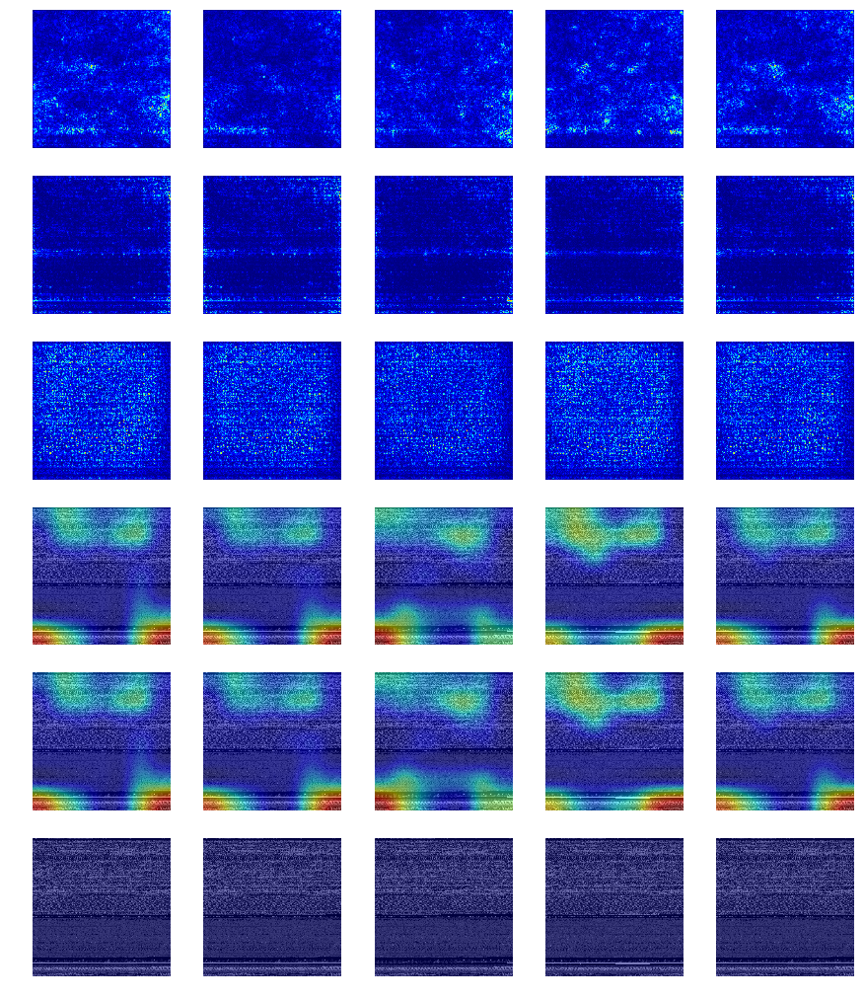

Family: Agent.FYI
Image: ['039107be5aa223a3331b3d45fe2bc839.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['0050d50c12a61ba4d96af715e43cc063.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['00e48bafce20c60339c96b59ae254bf6.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['0838c0449c2974662e35b2197d34c1d6.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)
Image: ['00324fff958d965a3a462a9775cc57ed.png'] - Class: ['Agent.FYI'] - Pred: 1 (Agent.FYI)


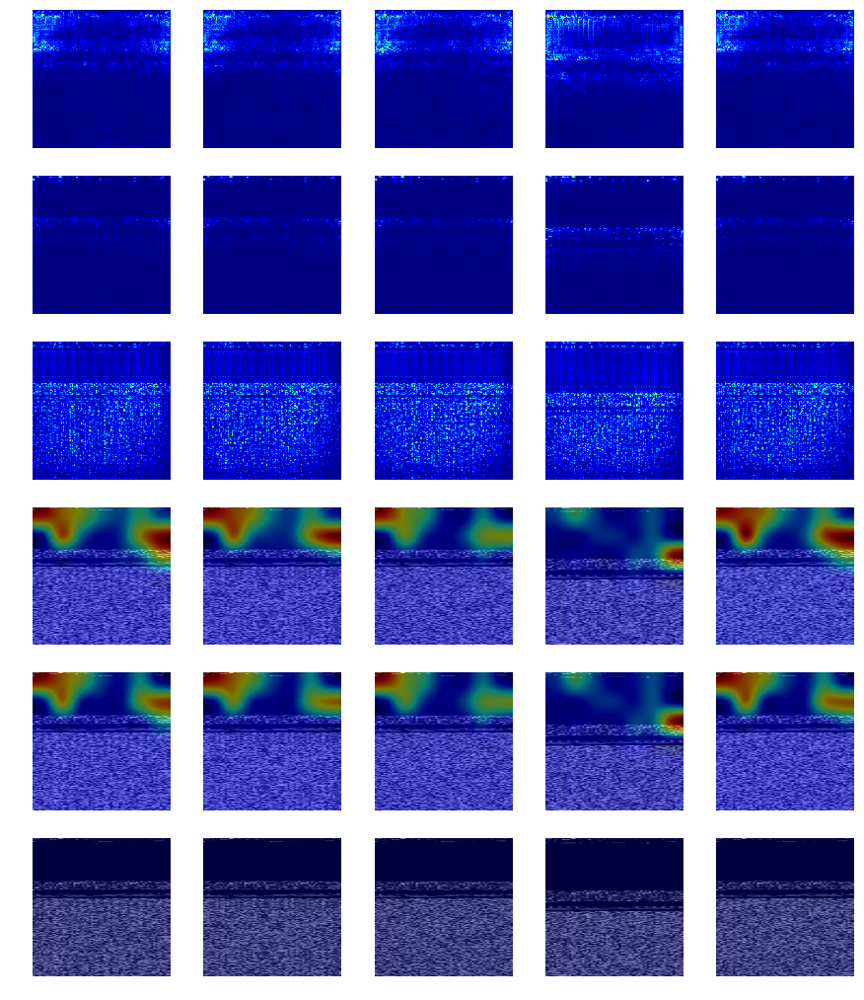

Family: Allaple.A
Image: ['0175686820aa39f4d79e0ceb80b7eb23.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['061602dabe733c1fb0c9064a18a33d08.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['00e24b52423ea41b2d391ae29ce3eb22.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['0025c917d3eef0428f92736bab0e6b9a.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)
Image: ['05ee4d0b4ea44e89b2507e6fd3a6b3d0.png'] - Class: ['Allaple.A'] - Pred: 2 (Allaple.A)


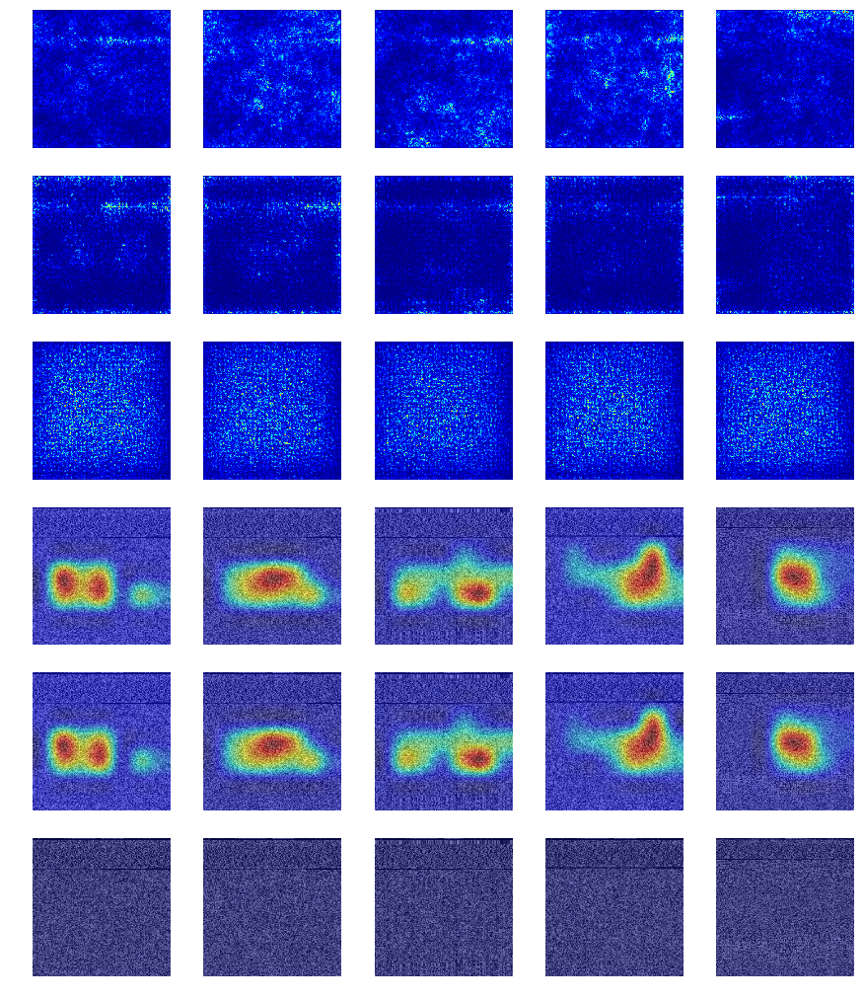

Family: Allaple.L
Image: ['043040a9fdc7f643962d1d216163b0d3.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['05938dbae5e83ddf3c324a4caca715b3.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['019149236b9d60c22cef707db3ed95c0.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['03890e0e4ec99d92b7bcbbbd5462636e.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)
Image: ['0156fe062052647f5097920e4ded29ef.png'] - Class: ['Allaple.L'] - Pred: 3 (Allaple.L)


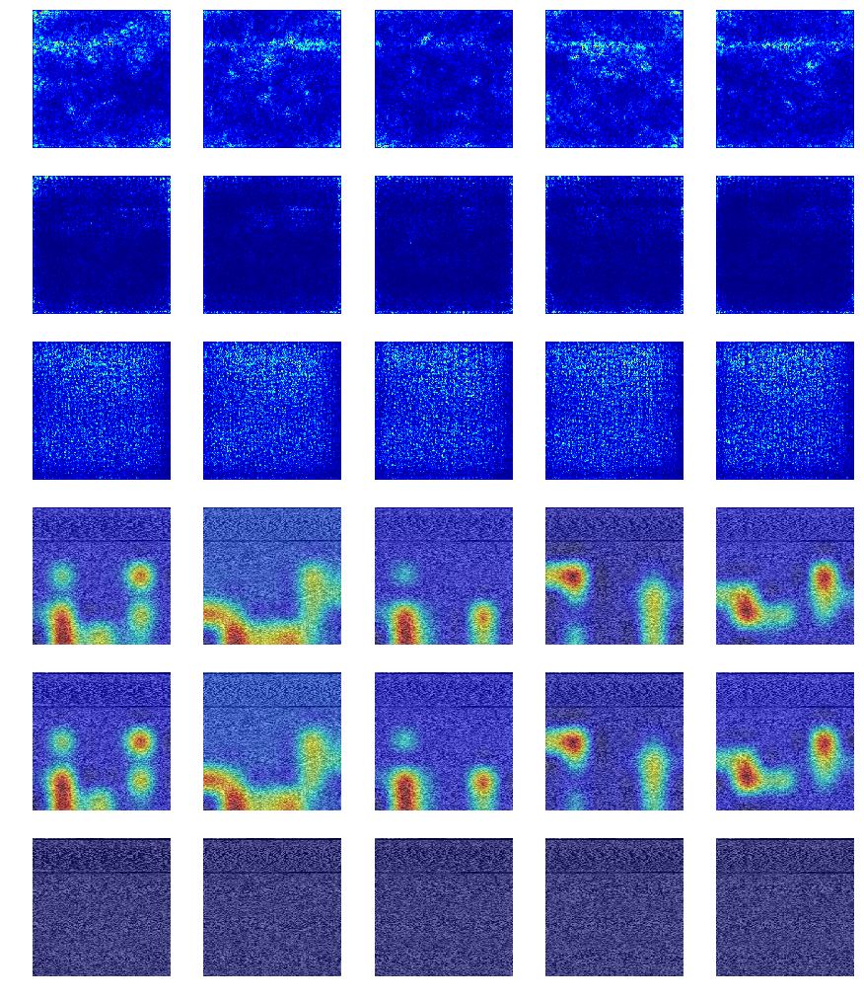

Family: Alueron.gen!J
Image: ['00c04d283e60a7026b00ebf605941ce6.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['089de27019e5b00e0f87827adc88f170.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['0175a4f6ac041432020a5d223d0c361d.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['0090cc9aceba78c906394bf701e8278f.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)
Image: ['0770b71ade5f85b0fa6478dc40cb7296.png'] - Class: ['Alueron.gen!J'] - Pred: 4 (Alueron.gen!J)


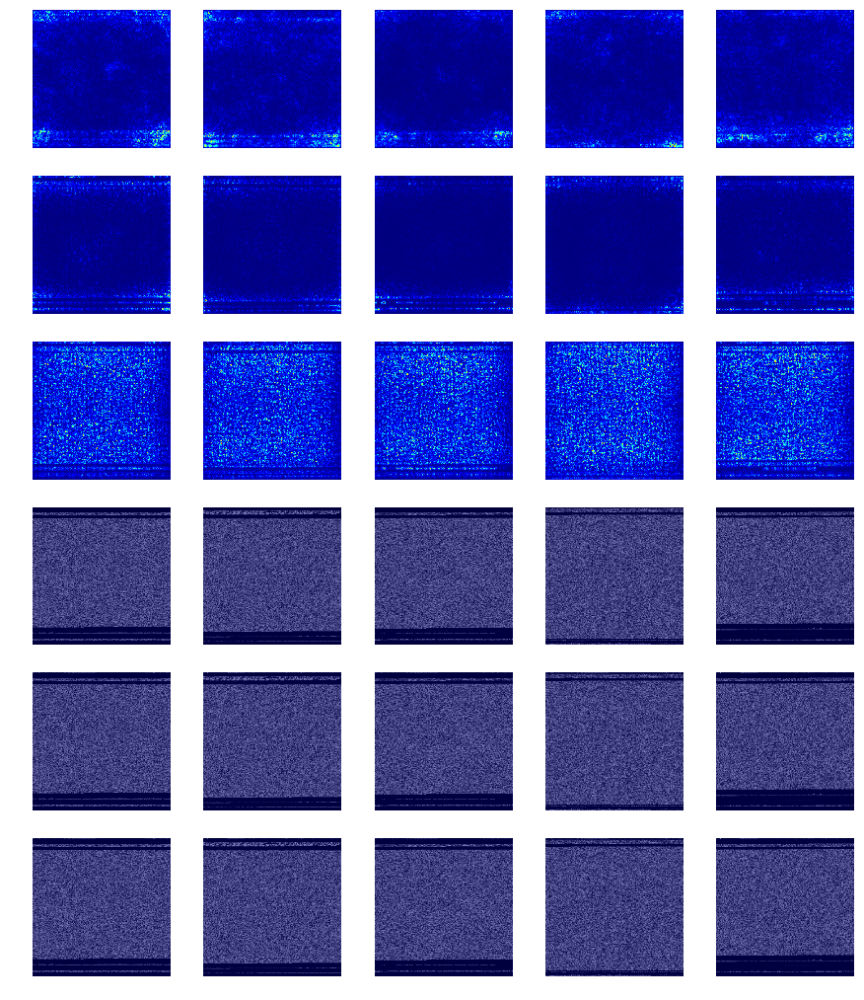

Family: Autorun.K
Image: ['088d1644ef5d130484b55b8d59ad79f9.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['0625611df93d914d868db99b8fea3bf4.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['053c59fc876a2f7e68f88f90e1aea844.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['0070fde0e8bb0e9abbbe1e3a54ae962a.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)
Image: ['0745c49b810c1e6347da9758ff06ad9a.png'] - Class: ['Autorun.K'] - Pred: 24 (Yuner.A)


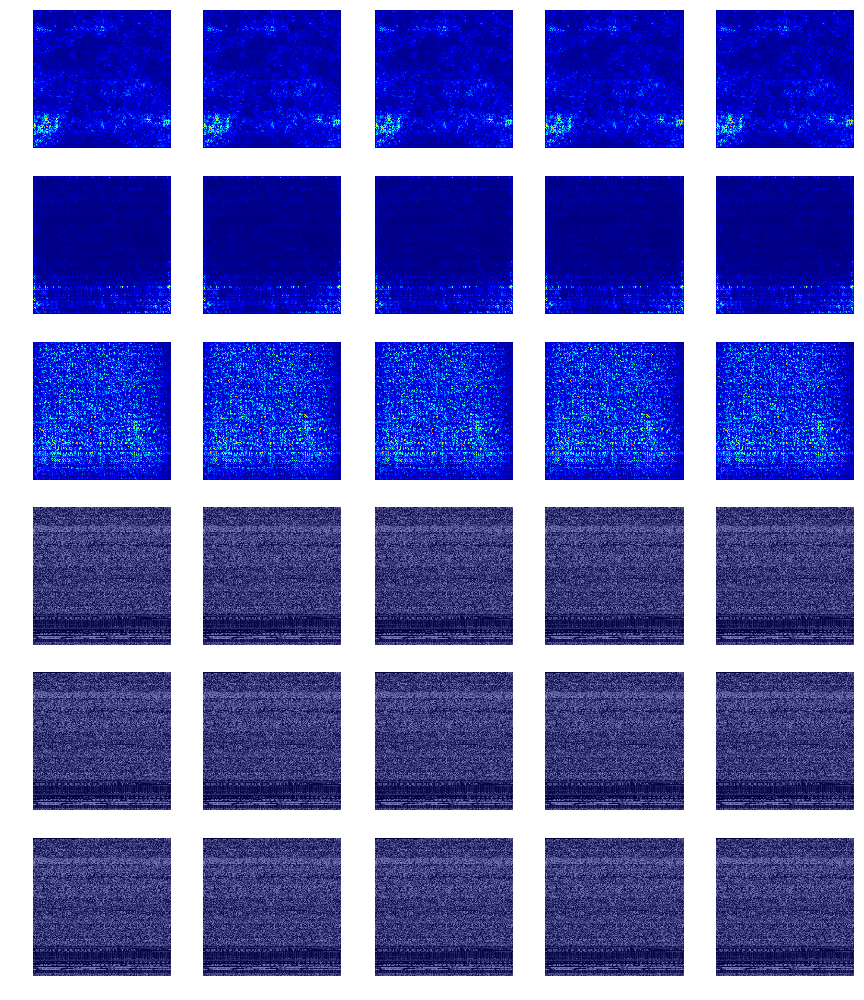

Family: C2LOP.gen!g
Image: ['01e92d6ebbe42a1b833ec3068029abd9.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0471f4893d6eb617d4f377fd4955bb90.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0148023bbbdbb44c1e4b3806f27a2e88.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['0583f708caf3aabc4d3d880ca5d6e801.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)
Image: ['05661f2d36770fd45b191bb9219efc53.png'] - Class: ['C2LOP.gen!g'] - Pred: 6 (C2LOP.gen!g)


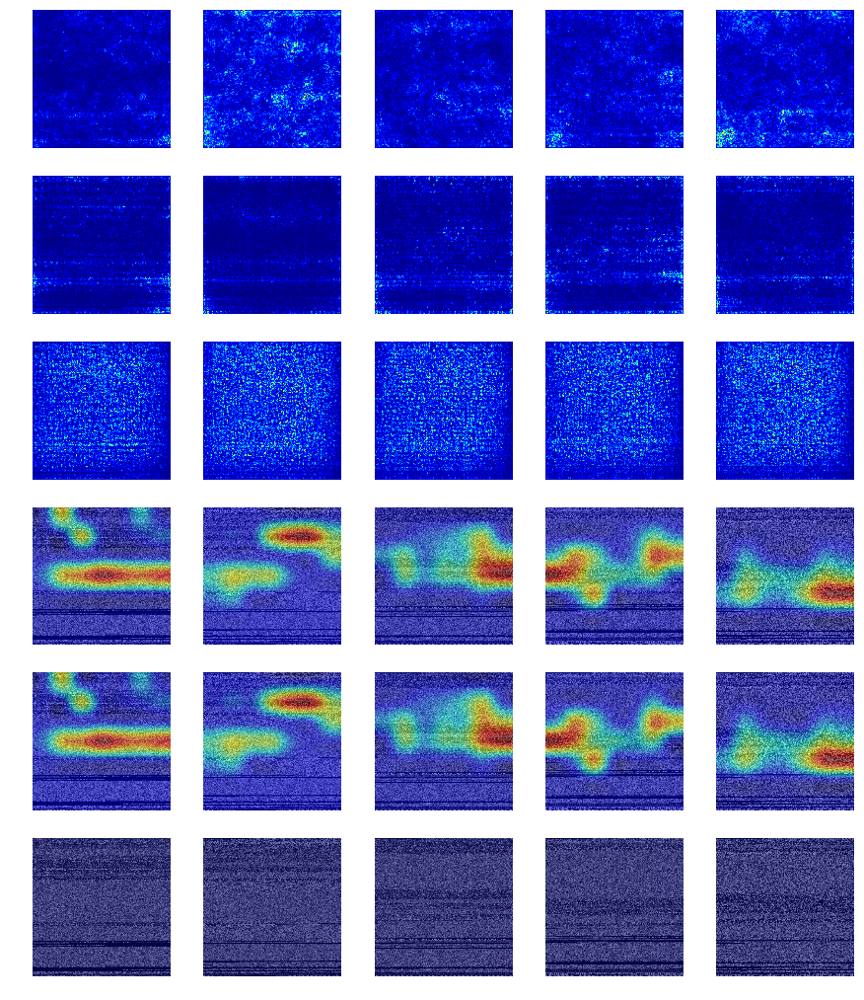

Family: C2LOP.P
Image: ['01d7812c8afd73d2daa088e8568d5c07.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['085fbc91ee6d6a13c29688f06a7450dc.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['00f2f382bed43b045d8773eb72efc3e1.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['0856008b55b46741446d285d1fb9c8e8.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)
Image: ['03fb0b6f6d5b251aa4352842589e0861.png'] - Class: ['C2LOP.P'] - Pred: 7 (C2LOP.P)


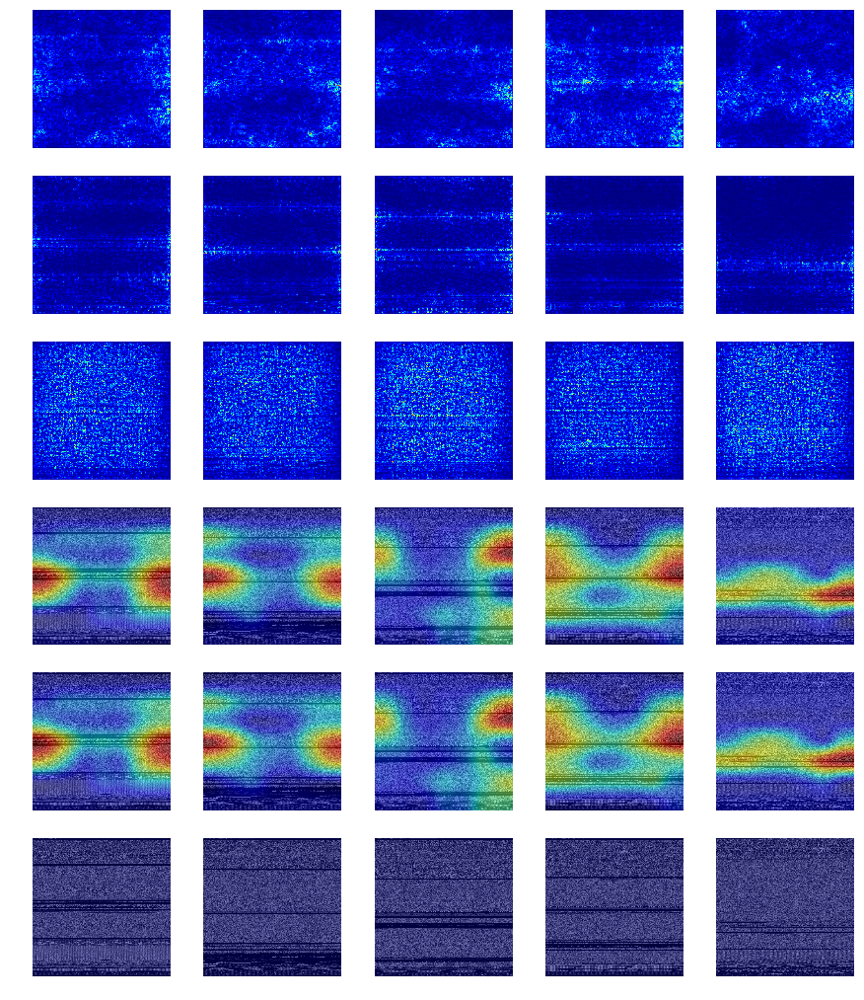

Family: Dialplatform.B
Image: ['0675c0c82a178c0cddb6fdb41c0bc776.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['009bfe416dded6ee8fc8bc533dfeeaa5.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['0090628f1b979a555db5f92146dcf179.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['06b98b9f7575c0163df99b146b0a6457.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)
Image: ['0510acbc179b01d7613497fb826fda9a.png'] - Class: ['Dialplatform.B'] - Pred: 8 (Dialplatform.B)


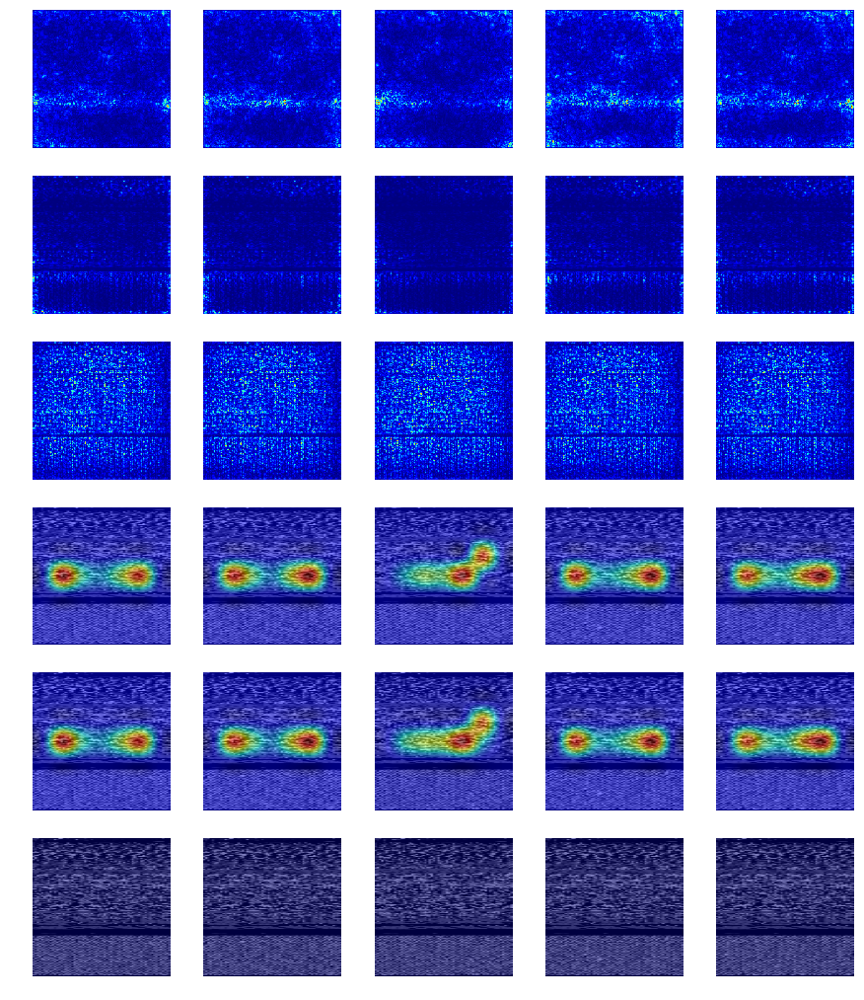

Family: Dontovo.A
Image: ['06adcbc474e114d1bbce4f4f79167eaf.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['01e3751c159e458d0c49e0d9473a0e1c.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['07071302467c6fbeb46761255614655f.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['0639f1166ccb08faccb57e7784977ec7.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)
Image: ['0694d2eaf437642960ae81441f681a3d.png'] - Class: ['Dontovo.A'] - Pred: 9 (Dontovo.A)


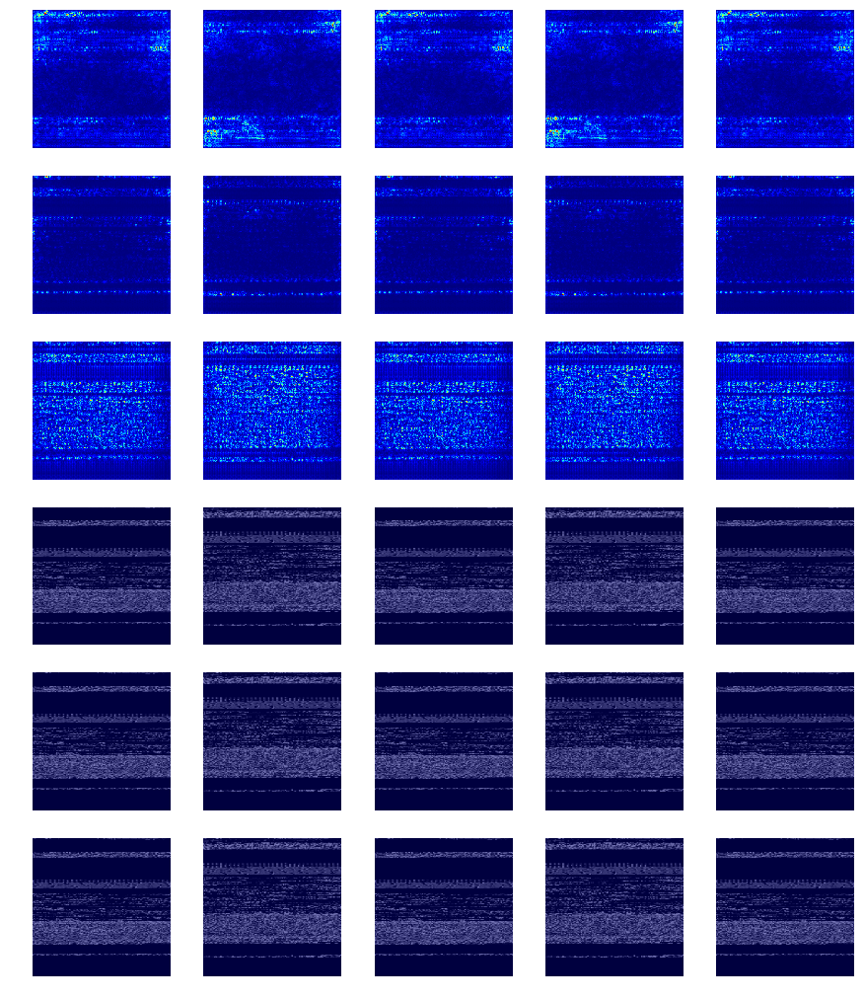

Family: Fakerean
Image: ['0005f5bdae46ea2d6d502b04fd2d0d5f.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['03b1eb8a4a23a50253eae125e2567b5e.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['02c554c0aade99403688f512d9662dfb.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['01164e90f5263475b2e7691415653cd6.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)
Image: ['0351fa37fb772961216a63dc7f75841b.png'] - Class: ['Fakerean'] - Pred: 10 (Fakerean)


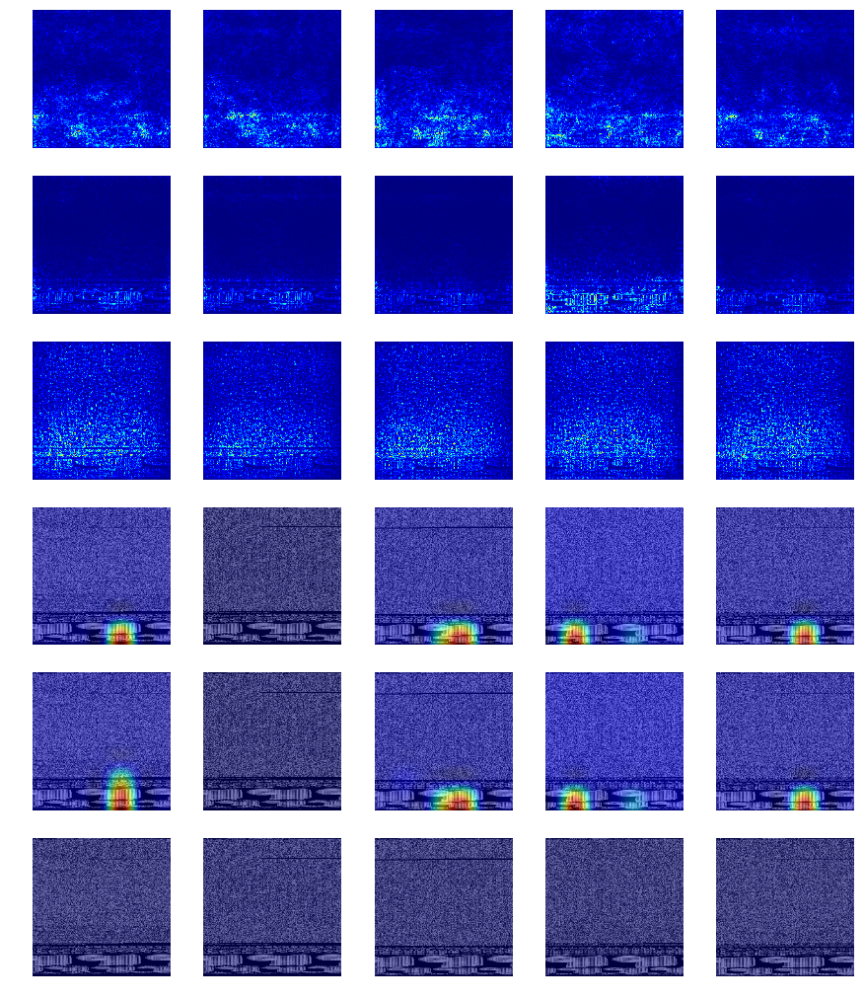

Family: Instantaccess
Image: ['02ed2471b419239a1073734f7551fa4f.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['03e95d829fc767eddc17d0c4f388558b.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['0595d5d6789610ed69f93dcae4a18f3d.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['057ce8dc0ff26183c2c2a6447525a382.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)
Image: ['008044928ce1c023bbca36e911c2facd.png'] - Class: ['Instantaccess'] - Pred: 11 (Instantaccess)


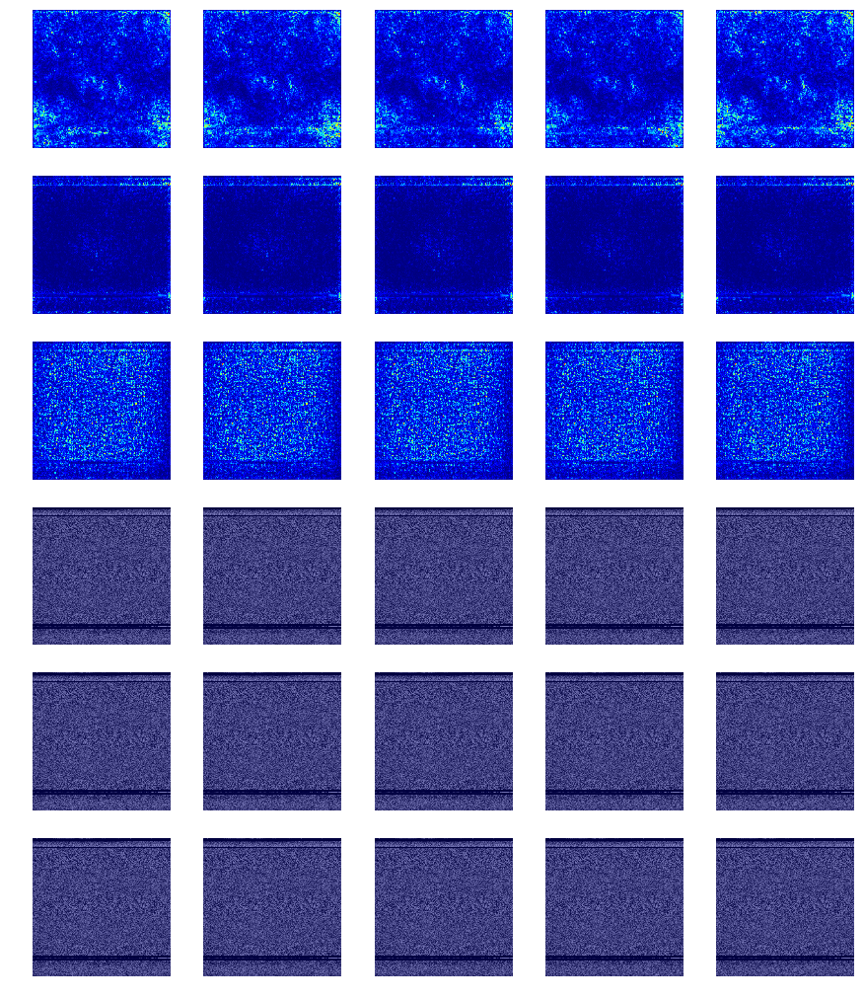

Family: Lolyda.AA1
Image: ['000f03b210bda3150d7c6b663112cf1d.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['01dc528acbbc4485985afff8436da596.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['001bbfbe7ea63b36ec96ad8959435cc9.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00ffa9f056ca732636bf9ece205e1d2c.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)
Image: ['00ab4b2f1dbb7dde44139294d648d6d0.png'] - Class: ['Lolyda.AA1'] - Pred: 12 (Lolyda.AA1)


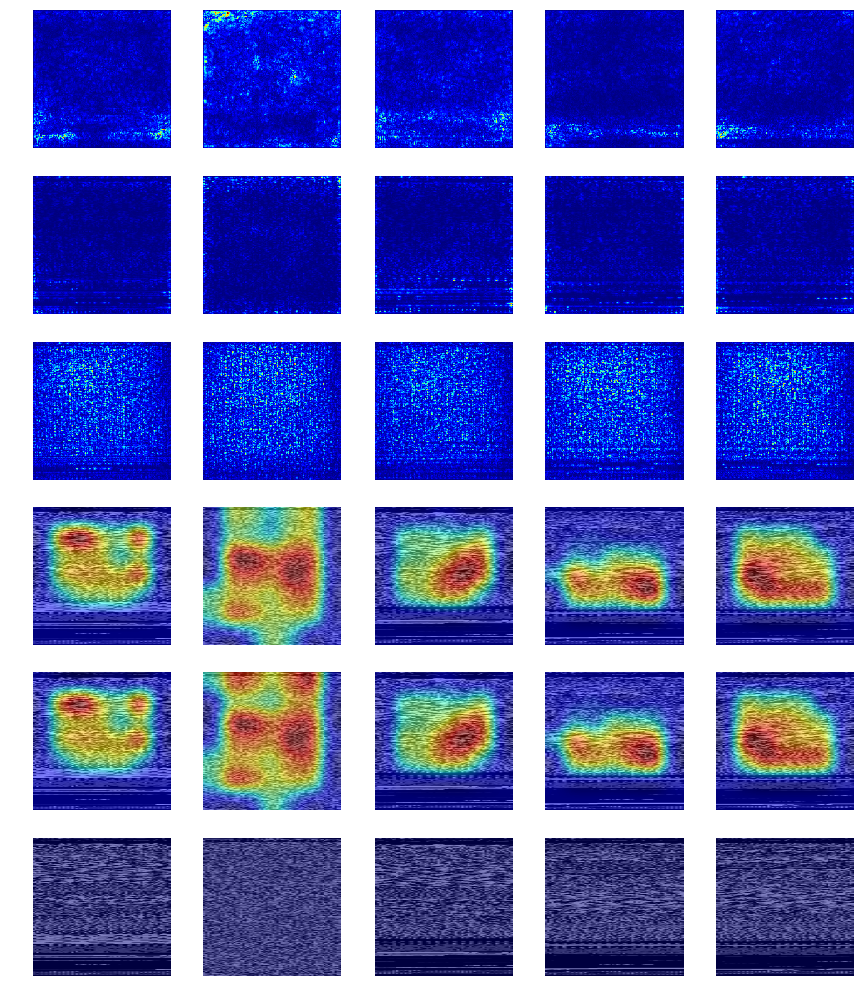

Family: Lolyda.AA2
Image: ['003442b16045330342e2bae33fcc1ee6.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0008dce0ead7a67f6d22d2146ea2716a.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00b774e91bf828fc282d07f365da4bfa.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['0019a179e375ee4d2da65b5e0da9ea28.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)
Image: ['00e68874a5b0cc21d0482b1c94329346.png'] - Class: ['Lolyda.AA2'] - Pred: 13 (Lolyda.AA2)


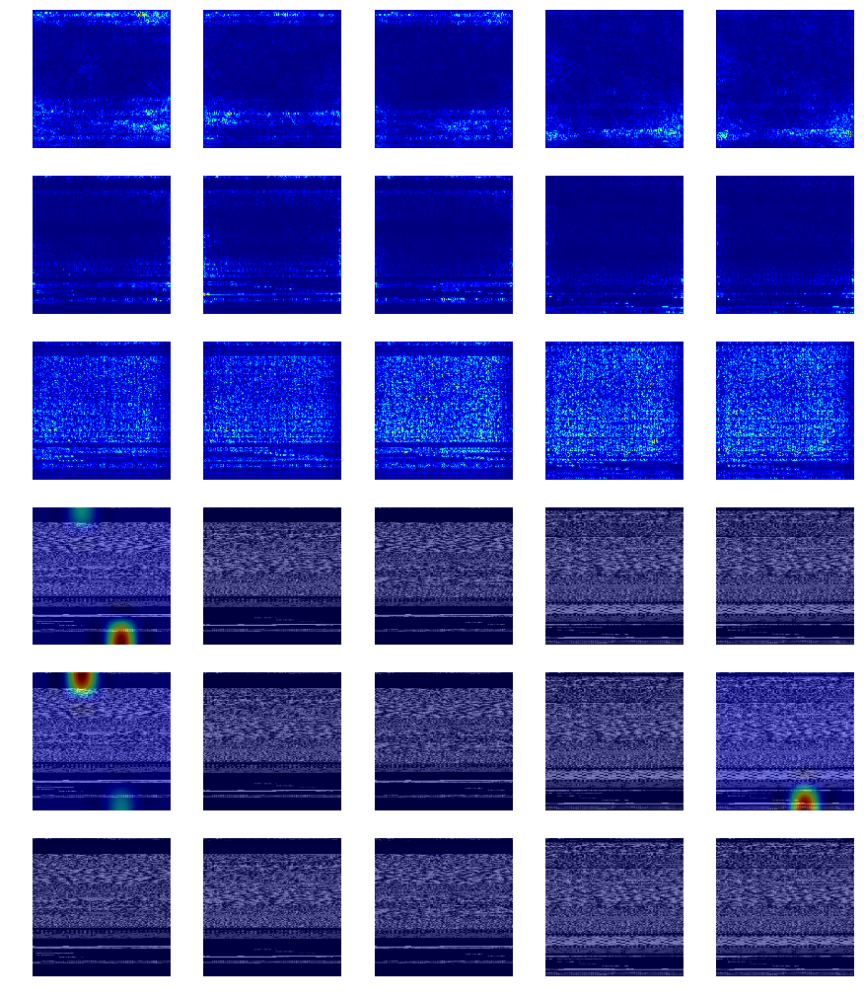

Family: Lolyda.AA3
Image: ['0082d2ac162488719aa11f67a6fe717c.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['001cafb3bc2211571be74c3d21a28c25.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['004d98785679fa5fc7c014f7860f7ca1.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00029d5e88b8ae1e36f1bb8e9611a0a4.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)
Image: ['00ef91c2ba2e61d27434cb65d78b9d7b.png'] - Class: ['Lolyda.AA3'] - Pred: 14 (Lolyda.AA3)


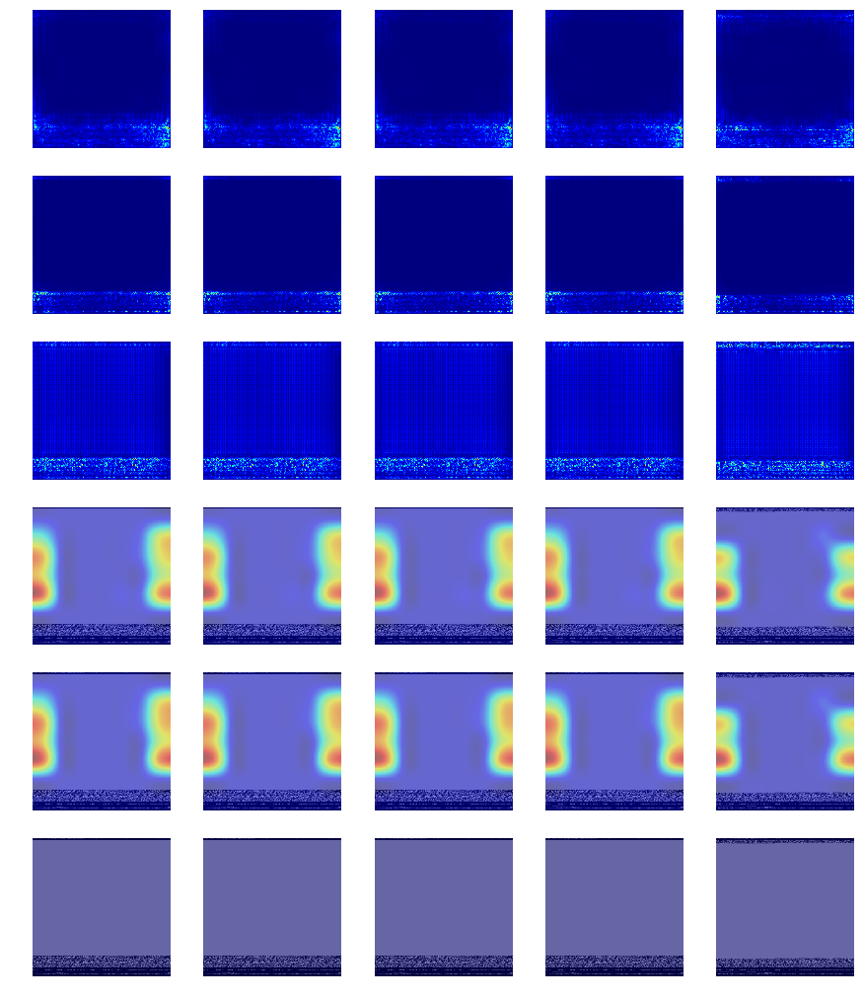

Family: Lolyda.AT
Image: ['0890b078c64ef3e894413e99e9f631ae.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['03f39d07c4b54adc1b7e765e16abeb9b.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['01e5e603355f4b74d27489542f2373bd.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['0683a456f253639fbf5603a9e5286704.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)
Image: ['022e210b2a17fe8a5f9b072c29595367.png'] - Class: ['Lolyda.AT'] - Pred: 15 (Lolyda.AT)


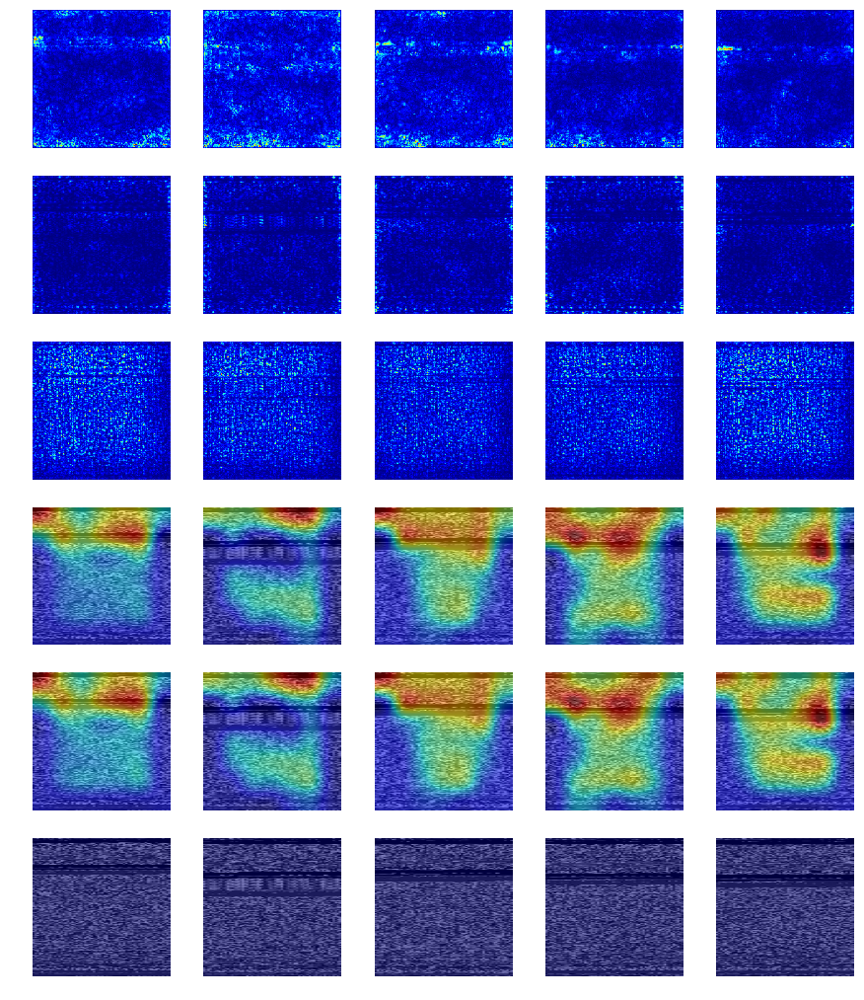

Family: Malex.gen!J
Image: ['014d1a919f99ec3364239d45fc091277.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['0635a56172dfe322edd1933d115516c8.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['07e6531e34318f32bd11a00319ed3ebb.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['064ee931b959ccdb3d6624c8acd40782.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)
Image: ['07b50b7de7abb1d9b9d239d52ea26092.png'] - Class: ['Malex.gen!J'] - Pred: 16 (Malex.gen!J)


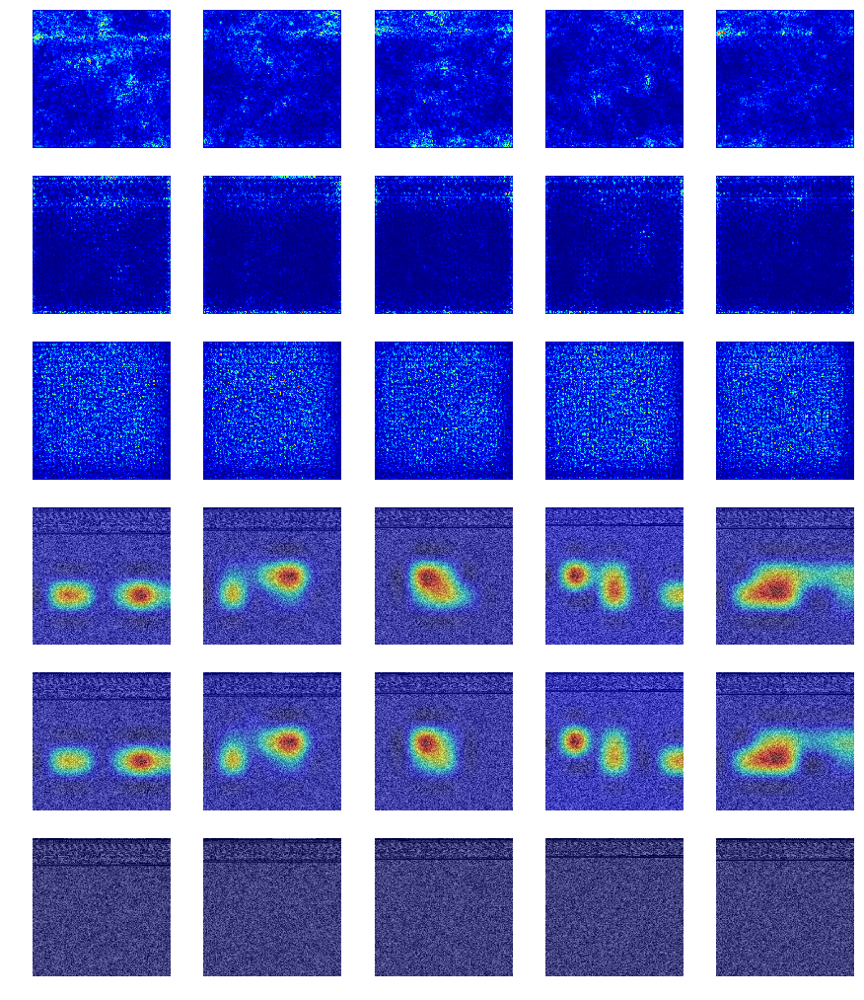

Family: Obfuscator.AD
Image: ['01d2ad470547cf6e4e8e814cc9e03a1a.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['063fd6a7e053fb0ff655a90e7d5d8512.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['041fbdd9eea3adfb59748082dde3e4b7.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['03b5390796da5c48db7b924af3cc258d.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)
Image: ['01bf1a241c90be96ec5f92d72f893716.png'] - Class: ['Obfuscator.AD'] - Pred: 17 (Obfuscator.AD)


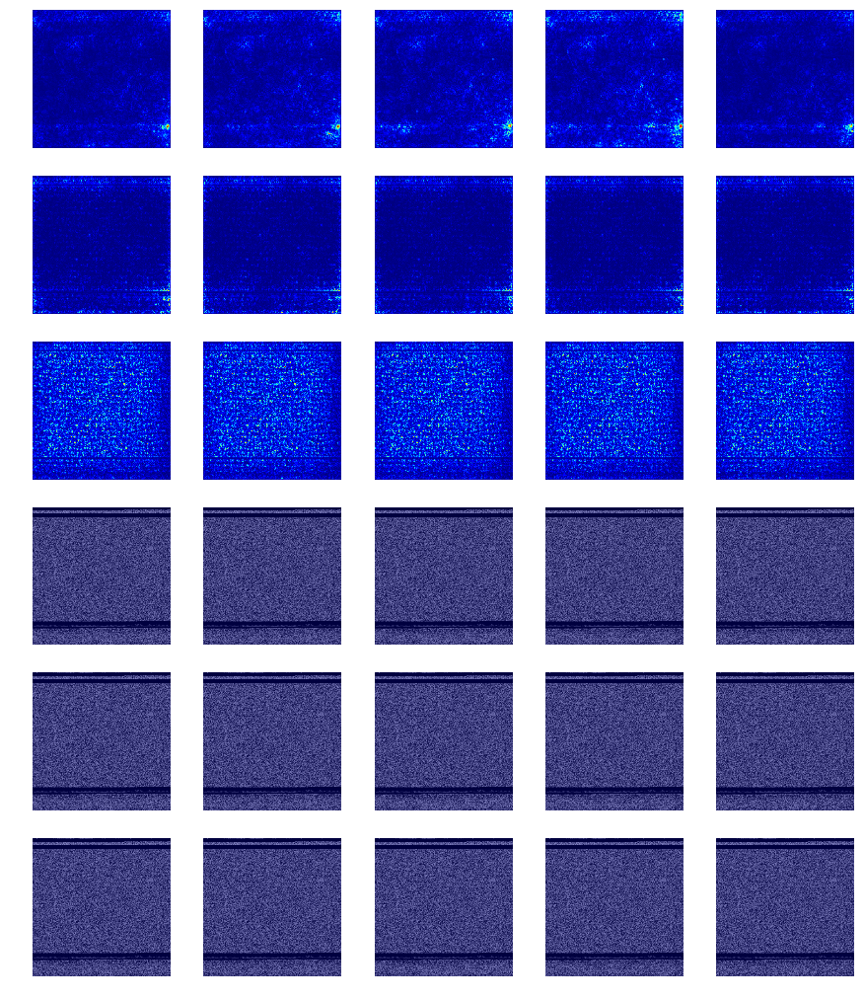

Family: Rbot!gen
Image: ['70a83377ce93f88db5b210ffe5390578.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['859f5cdecd66d101de479299961407b8.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['5ed95b4dfece70ebc6ffbeb9659c9df5.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['cdea77e0f0acb42424eebaa48cd09147.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)
Image: ['2561d2effe769aa9dfaa8840c0167698.png'] - Class: ['Rbot!gen'] - Pred: 18 (Rbot!gen)


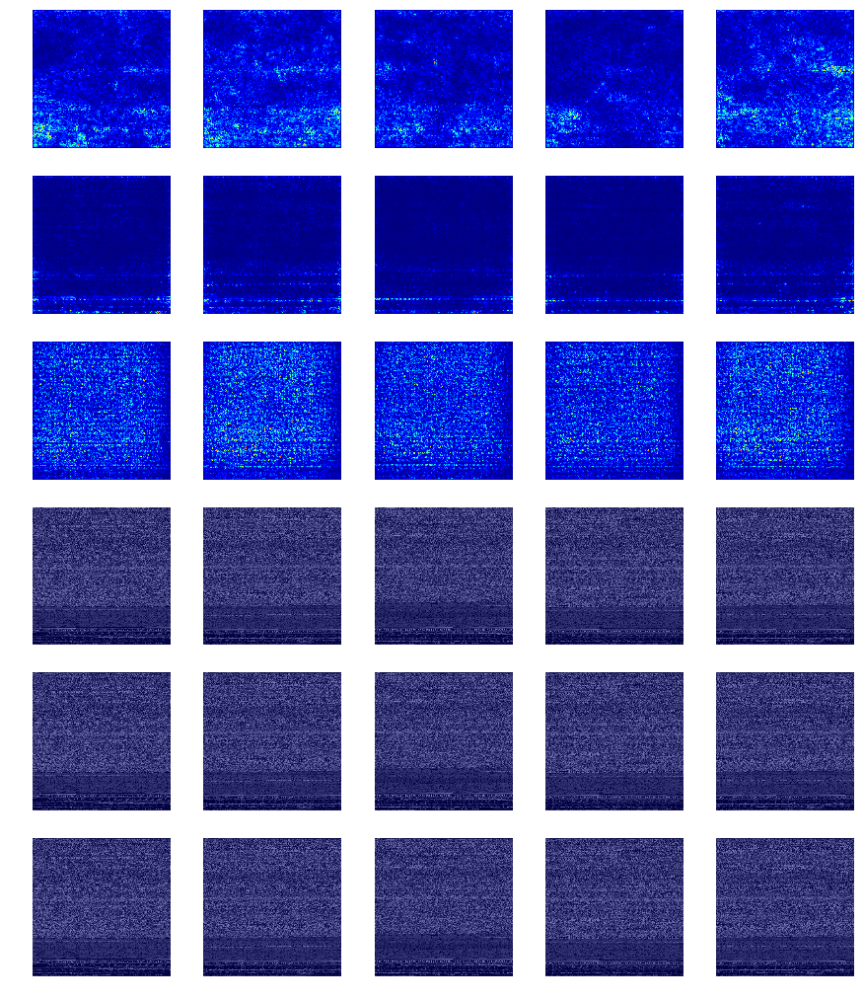

Family: Skintrim.N
Image: ['0004b01795a4b56c3fb29fe60d8ac476.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['0006a4c1926641f068d00d8f2f62f7d3.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['000ae8c2522bd2309aff9e156a60c5cf.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['0006b7efc46b2a927b020478157e431e.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)
Image: ['00d0129581c902f9b74c7199cbdeb6d7.png'] - Class: ['Skintrim.N'] - Pred: 19 (Skintrim.N)


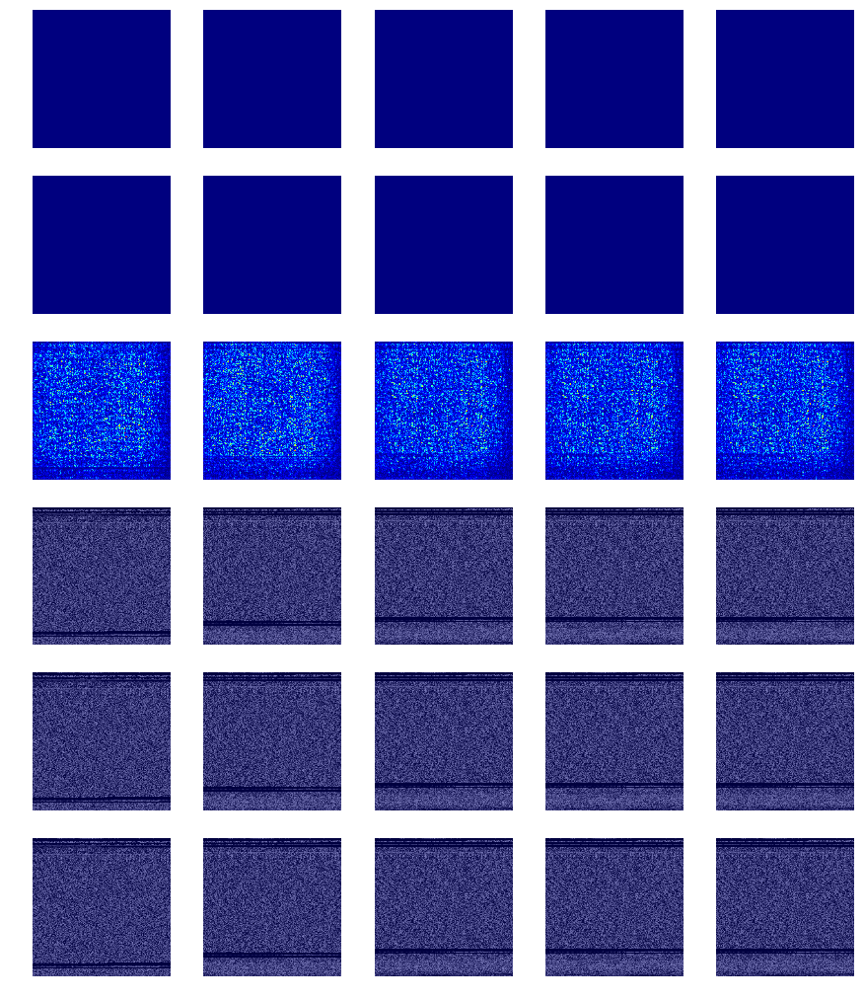

Family: Swizzor.gen!E
Image: ['06643e13061fc35f37955f4edf901f51.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['005c89d60814e4c30683c532d5d4bbfe.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['071b19ab5952153c8dc24c0a0eaf4d52.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['085fdcbd6096c0204858c8f560bb4c39.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)
Image: ['00231bd15cd714c3604d0ab60c3f0ec3.png'] - Class: ['Swizzor.gen!E'] - Pred: 20 (Swizzor.gen!E)


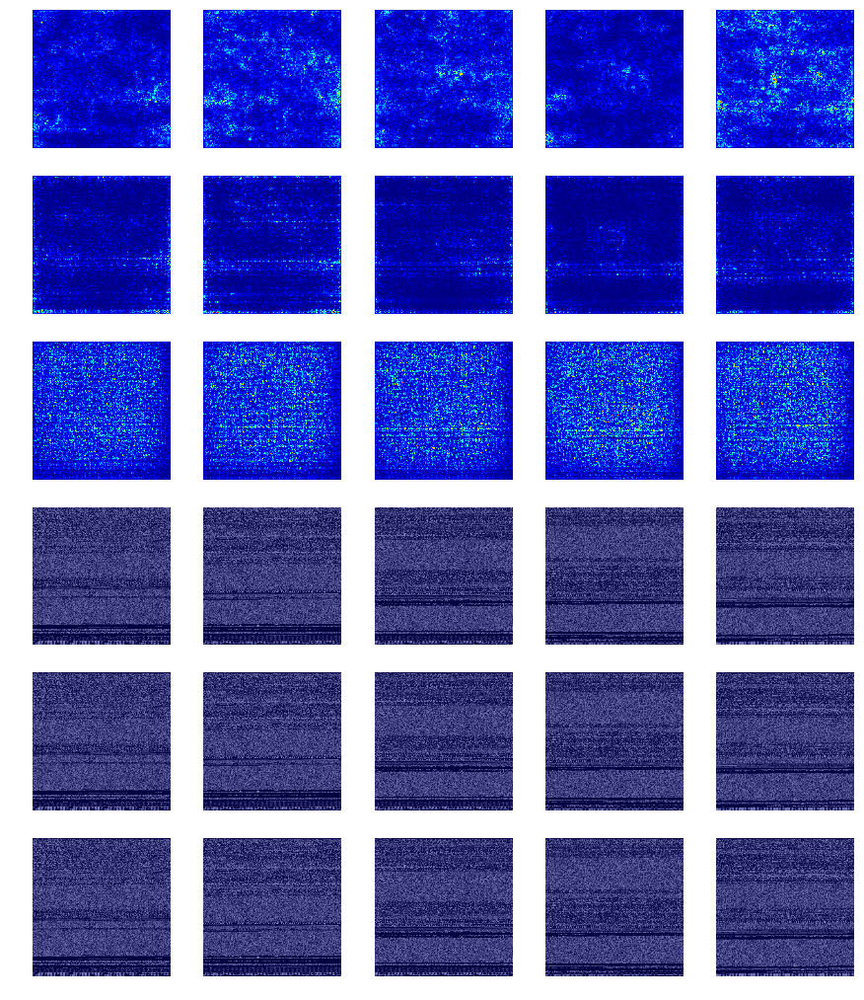

Family: Swizzor.gen!I
Image: ['04b5b000035a9c0e5563633a97b313e1.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['00d2b8618eae05e0d3d3b2f936ad3e1b.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['01a7b5f72bcd6105a21b451439472ede.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['064aff9ef81faf72bd077e6b1004ee36.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)
Image: ['07b103b69f31df41818cc7b45ce31ddb.png'] - Class: ['Swizzor.gen!I'] - Pred: 21 (Swizzor.gen!I)


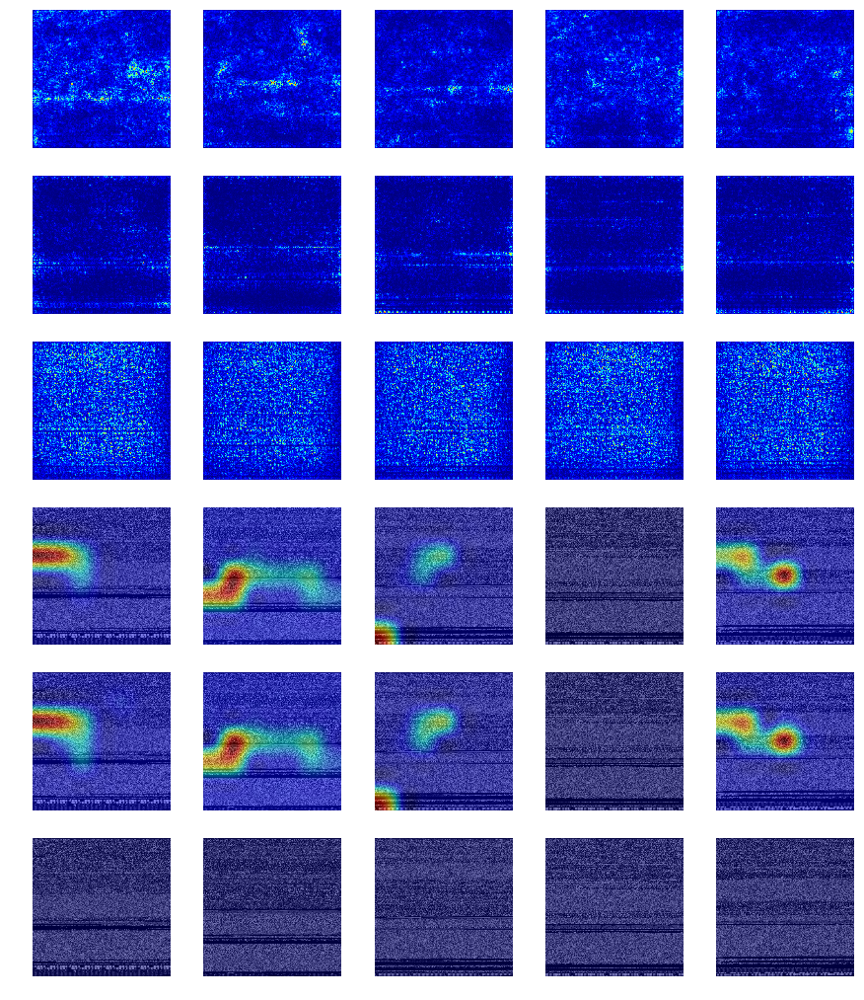

Family: VB.AT
Image: ['046f1b08f15b1a4ee455e81f4ad2311f.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['01f37a808c9d87082f52c81cb7e6d35b.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['058be829a3bdabc4067d1d34bf6fbcec.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['06c7cde6c93da86e108f859153ae803a.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)
Image: ['02dbb79ce40ca3d62409bda46ba9bd2c.png'] - Class: ['VB.AT'] - Pred: 22 (VB.AT)


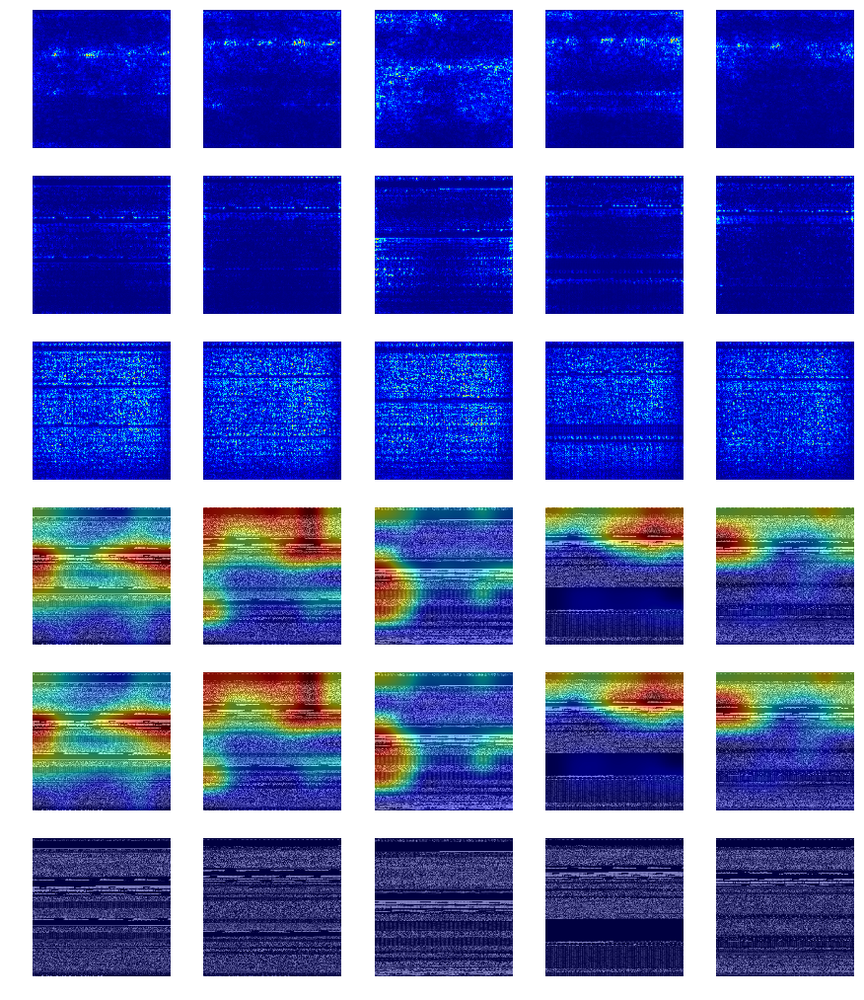

Family: Wintrim.BX
Image: ['0023ec3fb700f5150df1bf41ad0fd68a.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00ed23a45f7854b33cea5b0880d67e56.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['007b839f1227be054a927b9179b3748d.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00d2defd9b39e2fd9c35fcea11c94a7f.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)
Image: ['00f1b15bb60b62513716af3b22bd5fb8.png'] - Class: ['Wintrim.BX'] - Pred: 23 (Wintrim.BX)


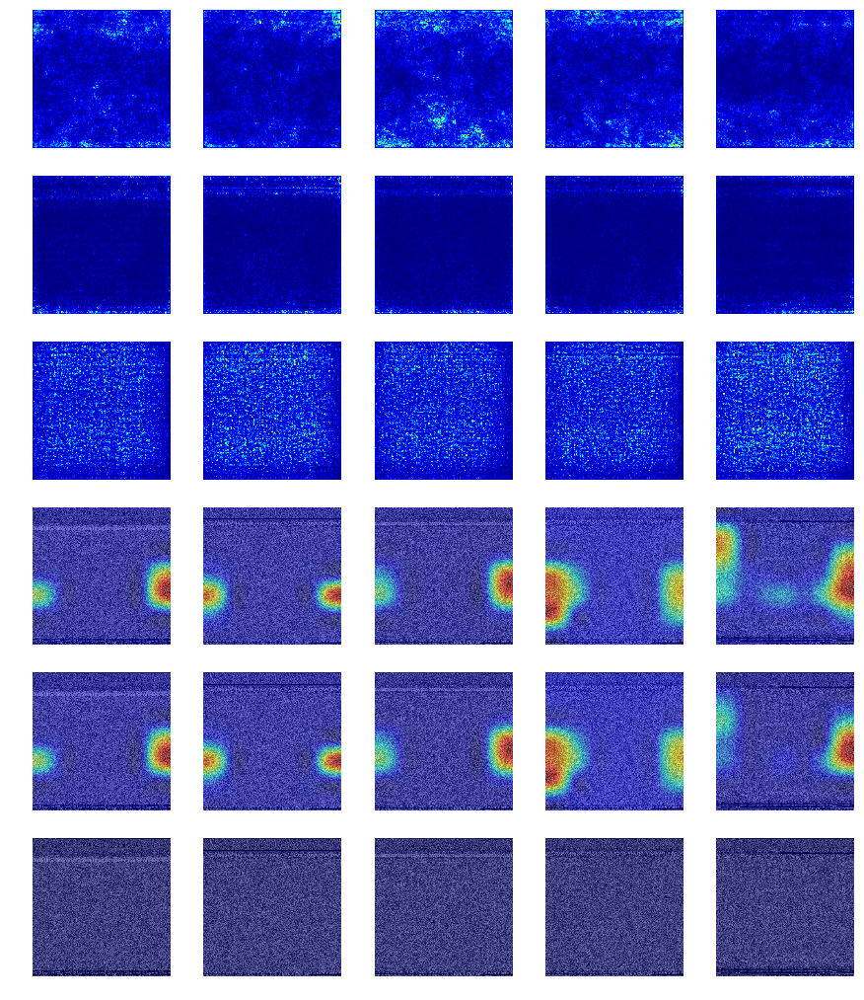

Family: Yuner.A
Image: ['0021eae849b5c0a4ced14d3daf34b102.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['0814befedd8c789a9fae2ca309348ce7.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['07ad187f285af5a7de79d32418ec9705.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['08a2cf4d9b148c7e5e151202084ce60a.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)
Image: ['03f56f720a1814bf7d1a63cd9dd6f44a.png'] - Class: ['Yuner.A'] - Pred: 24 (Yuner.A)


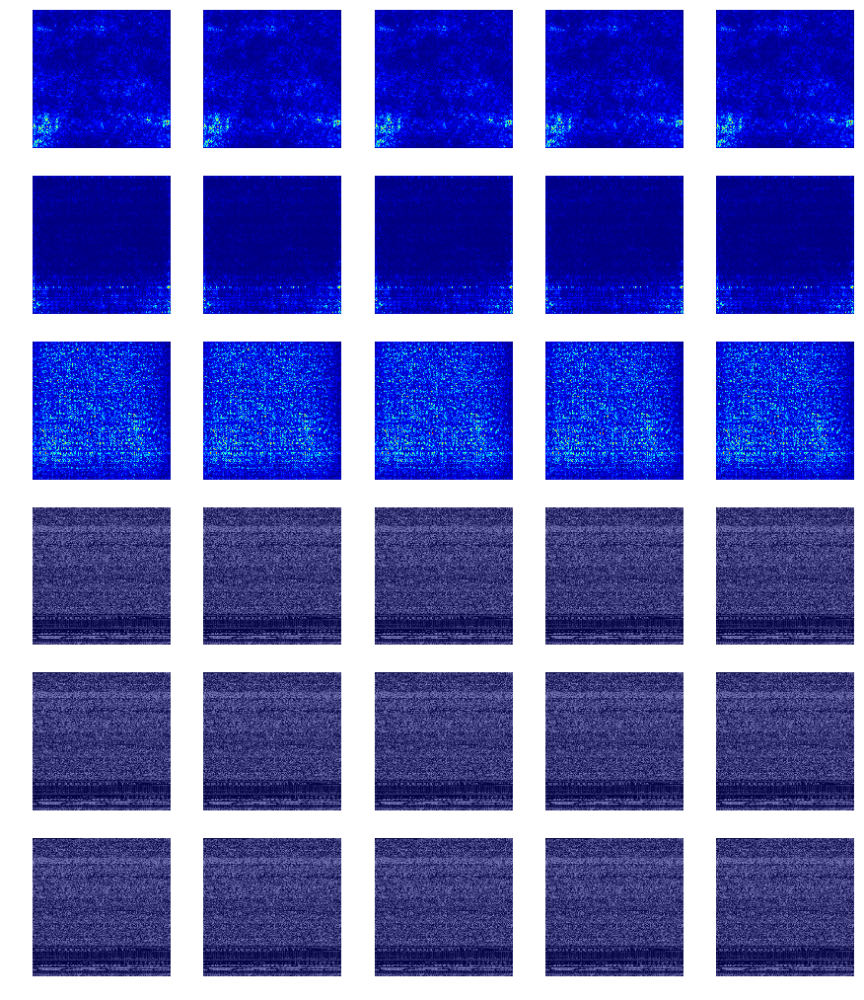

In [11]:
samplesbyfamily = 5 
for fam in list_fams:
    print("Family: %s" %(fam))
    fam_samples = [name for name in list_paths if fam in name]
    image_paths = random.sample(fam_samples, samplesbyfamily)
    
    #fig = plt.figure(figsize=(16, 8))
    f, ax = plt.subplots(6, samplesbyfamily)
    f.set_size_inches(3*samplesbyfamily, 3*6)
    ind = 0
    
    for path in image_paths:
        # Predict the corresponding class for use in `visualize_cam`.
        img = io.imread(path)
        img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
        img = cv2.resize(img, (224, 224))
        pred_class = np.argmax(model.predict(np.array([img_to_array(img)])))
        print("Image: %s - Class: %s - Pred: %d (%s)" %(path.split('/')[-1:],path.split('/')[-2:-1],pred_class,list_fams[pred_class]))
        
        grads = visualize_saliency(model, layer_idx, filter_indices=[pred_class], seed_input=img)
        gradsguided = visualize_saliency(model, layer_idx, filter_indices=[pred_class], seed_input=img, backprop_modifier='guided')
        gradsrelu = visualize_saliency(model, layer_idx, filter_indices=[pred_class], seed_input=img, backprop_modifier='relu')
        heatmap = visualize_cam(model, layer_idx, filter_indices=[pred_class], seed_input=img)        
        heatmapguided = visualize_cam(model, layer_idx, filter_indices=[pred_class], seed_input=img, backprop_modifier='guided')        
        heatmaprelu = visualize_cam(model, layer_idx, filter_indices=[pred_class], seed_input=img, backprop_modifier='relu')        

        ax[0,ind].axis('off')
        ax[0,ind].imshow(grads, cmap='jet')
        ax[1,ind].axis('off')
        ax[1,ind].imshow(gradsguided, cmap='jet')
        ax[2,ind].axis('off')
        ax[2,ind].imshow(gradsrelu, cmap='jet')
        ax[3,ind].axis('off')
        ax[3,ind].imshow(overlay(heatmap, img))
        ax[4,ind].axis('off')
        ax[4,ind].imshow(overlay(heatmapguided, img))
        ax[5,ind].axis('off')
        ax[5,ind].imshow(overlay(heatmaprelu, img))
        ind = ind + 1
        
    plt.show()